In [1]:
%matplotlib inline
%load_ext autoreload
%autoreload 2

This notebook contains some super rough and ugly explorations and trial runs into different ways of making interactive maps.

## Geo maps example

From https://medium.com/plotly/5-awesome-tools-to-power-your-geospatial-dash-app-c71ae536750d

In [5]:
import plotly.express as px
import geopandas as gpd
import shapely.geometry
import numpy as np

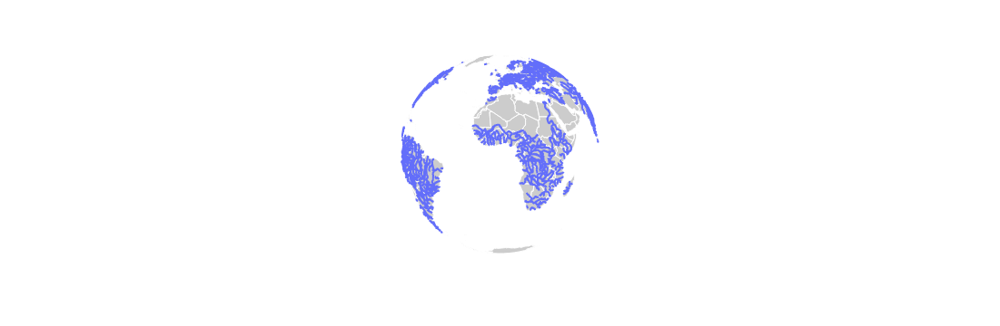

In [6]:
# open a zipped shapefile with the zip:// pseudo-protocol
geo_df = gpd.read_file("/Users/barbara/dark-matter/mers/phylo-paper/figures/map/ne_10m_rivers_lake_centerlines.zip")
 
lats = []
lons = []
names = []
 
for feature, name in zip(geo_df.geometry, geo_df.name):
   if isinstance(feature, shapely.geometry.linestring.LineString):
       linestrings = [feature]
   elif isinstance(feature, shapely.geometry.multilinestring.MultiLineString):
       linestrings = feature.geoms
   else:
       continue
   for linestring in linestrings:
       x, y = linestring.xy
       lats = np.append(lats, y)
       lons = np.append(lons, x)
       names = np.append(names, [name] * len(y))
       lats = np.append(lats, None)
       lons = np.append(lons, None)
       names = np.append(names, None)
 
fig = px.line_geo(
   lat=lats,
   lon=lons,
   hover_name=names,
   projection="orthographic",
)
 
# add some basic styling to the map
fig.update_geos(
   visible=False,
   resolution=50,
   showcountries=True,
   countrycolor="white",
   showland=True,
   landcolor="#cccccc",
)
fig.show()

## DashDeck demo

From https://medium.com/plotly/5-awesome-tools-to-power-your-geospatial-dash-app-c71ae536750d

In [3]:
import dash
import dash_deck.DeckGL as dgl
import pydeck
from dash import html

In [4]:
app = dash.Dash()
 
# Read Data 
DATA_URL = "https://raw.githubusercontent.com/visgl/deck.gl-data/master/examples/geojson/vancouver-blocks.json"
 
# Generate polygon layer 
polygon = pydeck.Layer(
   "PolygonLayer",
   [[[-123.0, 49.196], [-123.0, 49.324], [-123.306, 49.324], [-123.306, 49.196]]],
   stroked=False,
   get_polygon="-",
   get_fill_color=[0, 0, 0, 20],
)
 
# Generate geojson from data set
geojson = pydeck.Layer(
   "GeoJsonLayer",
   DATA_URL,
   extruded=True,
   get_elevation="properties.valuePerSqm / 20",
   get_fill_color="[255, 255, properties.growth * 255]",
)
 
# Set initial state
INITIAL_VIEW_STATE = pydeck.ViewState(
   latitude=49.254, longitude=-123.13, zoom=11, max_zoom=16, pitch=45, bearing=0
)
 
# Combine the multiple layers
r = pydeck.Deck(
   layers=[polygon, geojson],
   initial_view_state=INITIAL_VIEW_STATE,
   #mapbox_key=mapbox_api_token,
)
 
# Generate component to be passed into the Dash application
deck_component = (dgl(r.to_json(), id="deck-gl", mapboxKey=r.mapbox_key,))
 
 
# Putting the deck component in our app layout
app.layout = html.Div(deck_component)
 
 
if __name__ == "__main__":
   app.run_server()

# Folium

From https://autogis-site.readthedocs.io/en/2021/notebooks/L5/02_interactive-map-folium.html

In [23]:
import folium
from folium.plugins import MarkerCluster

In [26]:
# Filepaths
fp = "Vaestotietoruudukko_2015.shp"
addr_fp = "addresses.shp"

# Read Data
data = gpd.read_file(fp)
ad = gpd.read_file(addr_fp)

# Re-project to WGS84
data['geometry'] = data['geometry'].to_crs(epsg=4326)
ad['geometry'] = ad['geometry'].to_crs(epsg=4326)

# Update the CRS of the GeoDataFrame
#data.crs = from_epsg(4326)
#ad.crs = from_epsg(4326)

# Make a selection (only data above 0 and below 1000)
data = data.loc[(data['ASUKKAITA'] > 0) & (data['ASUKKAITA'] <= 1000)]

# Create a Geo-id which is needed by the Folium (it needs to have a unique identifier for each row)
data['geoid'] = data.index.astype(str)
ad['geoid'] = ad.index.astype(str)

# Select data
data = data[['geoid', 'ASUKKAITA', 'ASVALJYYS', 'geometry']]

# Save the file as geojson
jsontxt = data.to_json()

In [29]:
# Create a Map instance
m = folium.Map(location=[60.25, 24.8], tiles = 'cartodbpositron', zoom_start=10, control_scale=True)

# Plot a choropleth map
# Notice: 'geoid' column that we created earlier needs to be assigned always as the first column
folium.Choropleth(
    geo_data=data,
    name='Population in 2020',
    data=data,
    columns=['geoid', 'ASUKKAITA'], 
    key_on='feature.id',
    fill_color='YlOrRd',
    fill_opacity=0.7,
    line_opacity=0.2,
    line_color='white', 
    line_weight=0,
    highlight=False, 
    smooth_factor=1.0,
    #threshold_scale=[100, 250, 500, 1000, 2000],
    legend_name= 'Population in Helsinki').add_to(m)

# Convert points to GeoJson, add the hover labels
folium.features.GeoJson(data,  
                        name='Labels',
                        style_function=lambda x: {'color':'transparent','fillColor':'transparent','weight':0},
                        tooltip=folium.features.GeoJsonTooltip(fields=['ASUKKAITA', 'ASVALJYYS'],
                                                                aliases = ['Population', '??'],
                                                                labels=True,
                                                                sticky=False
                                                                            )
                       ).add_to(m)

# Add the layer control
folium.LayerControl().add_to(m)

#Show map
m

# Playing with dash-leaflet

In [36]:
from dash import Dash
import dash_leaflet as dl

app = Dash()
app.layout = dl.Map(dl.TileLayer(), center=[56,10], zoom=6, style={'height': '50vh'})

# if __name__ == '__main__':
#     app.run_server()

app.run(jupyter_mode="inline")

In [53]:
from dash_extensions.javascript import assign
from dash import Dash, html
from dash_leaflet import Map, TileLayer

eventHandlers = dict(
    dblclick=assign("function(e, ctx){ctx.setProps({data: 'Hello world!'})}"),
    contextmenu=assign("function(e, ctx){ctx.map.flyTo([13.87992, 45.9791], 12);}"),
    
)
app = Dash(__name__)
app.layout = Map(children=[TileLayer()], eventHandlers=eventHandlers,
                 style={'height': '50vh'}, center=[56, 10], zoom=6)

app.run(jupyter_mode="inline")

In [55]:
import dash_leaflet.express as dlx

# A few cities in Denmark.
cities = [dict(name="Aalborg", lat=57.0268172, lon=9.837735),
          dict(name="Aarhus", lat=56.1780842, lon=10.1119354),
          dict(name="Copenhagen", lat=55.6712474, lon=12.5237848)]
# Generate geojson with a marker for each city and name as tooltip.
geojson = dlx.dicts_to_geojson([{**c, **dict(tooltip=c['name'])} for c in cities])
# Create javascript function that filters out all cities but Aarhus.
geojson_filter = assign("function(feature, context){{return ['Aarhus', 'Aalborg'].includes(feature.properties.name);}}")
# Create example app.
app = Dash()
app.layout = html.Div([
    dl.Map(children=[
        dl.TileLayer(),
        dl.GeoJSON(data=geojson, filter=geojson_filter)
    ], style={'height': '50vh'}, center=[56, 10], zoom=6),
])

app.run(jupyter_mode="inline")

In [56]:
import dash_leaflet as dl
import dash_leaflet.express as dlx
from dash import Dash, html, dcc, Output, Input
from dash_extensions.javascript import assign

# A few cities in Denmark.
cities = [dict(name="Aalborg", lat=57.0268172, lon=9.837735),
          dict(name="Aarhus", lat=56.1780842, lon=10.1119354),
          dict(name="Copenhagen", lat=55.6712474, lon=12.5237848)]
# Create drop down options.
dd_options = [dict(value=c["name"], label=c["name"]) for c in cities]
dd_defaults = [o["value"] for o in dd_options]
# Generate geojson with a marker for each city and name as tooltip.
geojson = dlx.dicts_to_geojson([{**c, **dict(tooltip=c['name'])} for c in cities])
# Create javascript function that filters on feature name.
geojson_filter = assign("function(feature, context){return context.hideout.includes(feature.properties.name);}")
# Create example app.
app = Dash()
app.layout = html.Div([
    dl.Map(children=[
        dl.TileLayer(),
        dl.GeoJSON(data=geojson, filter=geojson_filter, hideout=dd_defaults, id="geojson")
    ], style={'height': '50vh'}, center=[56, 10], zoom=6),
    dcc.Dropdown(id="dd", value=dd_defaults, options=dd_options, clearable=False, multi=True)
])
# Link drop down to geojson hideout prop (could be done with a normal callback, but clientside is more performant).
app.clientside_callback("function(x){return x;}", Output("geojson", "hideout"), Input("dd", "value"))

app.run(jupyter_mode="inline")

In [61]:
import dash_leaflet as dl
from dash_extensions.javascript import assign
from dash import Dash

colorscale = ['red', 'yellow', 'green', 'blue', 'purple']  # rainbow
chroma = "https://cdnjs.cloudflare.com/ajax/libs/chroma-js/2.1.0/chroma.min.js"  # js lib used for colors
# Create a colorbar.
vmin = 0
vmax = 3500
colorbar = dl.Colorbar(colorscale=colorscale, width=20, height=150, min=vmin, max=vmax, unit='/km2')
# Geojson rendering logic, must be JavaScript as it is executed in clientside.
on_each_feature = assign("""function(feature, layer, context){
    layer.bindTooltip(`${feature.properties.city} (${feature.properties.density})`)
}""")
point_to_layer = assign("""function(feature, latlng, context){
    const {min, max, colorscale, circleOptions, colorProp} = context.hideout;
    const csc = chroma.scale(colorscale).domain([min, max]);  // chroma lib to construct colorscale
    circleOptions.fillColor = csc(feature.properties[colorProp]);  // set color based on color prop
    return L.circleMarker(latlng, circleOptions);  // render a simple circle marker
}""")
# Create geojson.
geojson = dl.GeoJSON(url="assets/us-cities.json",
                     zoomToBounds=True,  # when true, zooms to bounds when data changes
                     pointToLayer=point_to_layer,  # how to draw points
                     onEachFeature=on_each_feature,  # add (custom) tooltip
                     hideout=dict(colorProp='density', circleOptions=dict(fillOpacity=1, stroke=False, radius=5),
                                  min=vmin, max=vmax, colorscale=colorscale))
# Create the app.
app = Dash(external_scripts=[chroma], prevent_initial_callbacks=True)
app.layout = dl.Map([
    dl.TileLayer(), geojson, colorbar
], style={'height': '50vh'}, center=[56, 10], zoom=6)

app.run(jupyter_mode="inline")

In [66]:
import dash_leaflet as dl
import dash_leaflet.express as dlx
from dash import Dash, html, Output, Input
from dash_extensions.javascript import arrow_function, assign

def get_info(feature=None):
    header = [html.H4("US Population Density")]
    if not feature:
        return header + [html.P("Hoover over a state")]
    return header + [html.B(feature["properties"]["name"]), html.Br(),
                     "{:.3f} people / mi".format(feature["properties"]["density"]), html.Sup("2")]

classes = [0, 10, 20, 50, 100, 200, 500, 1000]
colorscale = ['#FFEDA0', '#FED976', '#FEB24C', '#FD8D3C', '#FC4E2A', '#E31A1C', '#BD0026', '#800026']
style = dict(weight=2, opacity=1, color='white', dashArray='3', fillOpacity=0.7)
# Create colorbar.
ctg = ["{}+".format(cls, classes[i + 1]) for i, cls in enumerate(classes[:-1])] + ["{}+".format(classes[-1])]
colorbar = dlx.categorical_colorbar(categories=ctg, colorscale=colorscale, width=300, height=30, position="bottomleft")
# Geojson rendering logic, must be JavaScript as it is executed in clientside.
style_handle = assign("""function(feature, context){
    const {classes, colorscale, style, colorProp} = context.hideout;  // get props from hideout
    const value = feature.properties[colorProp];  // get value the determines the color
    for (let i = 0; i < classes.length; ++i) {
        if (value > classes[i]) {
            style.fillColor = colorscale[i];  // set the fill color according to the class
        }
    }
    return style;
}""")
# Create geojson.
geojson = dl.GeoJSON(url="assets/us-states.json",  # url to geojson file
                     style=style_handle,  # how to style each polygon
                     zoomToBounds=True,  # when true, zooms to bounds when data changes (e.g. on load)
                     zoomToBoundsOnClick=True,  # when true, zooms to bounds of feature (e.g. polygon) on click
                     hoverStyle=arrow_function(dict(weight=5, color='#666', dashArray='')),  # style applied on hover
                     hideout=dict(colorscale=colorscale, classes=classes, style=style, colorProp="density"),
                     id="geojson")
# Create info control.
info = html.Div(children=get_info(), id="info", className="info",
                style={"position": "absolute", "top": "10px", "right": "10px", "zIndex": "1000"})
# Create app.
app = Dash(prevent_initial_callbacks=True)
app.layout = dl.Map(children=[
    dl.TileLayer(), geojson, colorbar, info
], style={'height': '50vh'}, center=[56, 10], zoom=6)

@app.callback(Output("info", "children"), Input("geojson", "hoverData"))
def info_hover(feature):
    return get_info(feature)

app.run(jupyter_mode="inline")

## Figuring out how to convert Shapefile to Geojson

In [10]:
import geopandas

In [9]:
myshpfile = geopandas.read_file('../../data/bevoelkerungsstatistik/Raumliche_Bevolkerungsstatistik_-OGD/BEVOELKERUNG_HA_F.shp')
myshpfile = myshpfile.to_crs(epsg=4326)
myshpfile.to_file('assets/myJson.geojson', driver='GeoJSON')

In [16]:
import rasterio
from rasterio.features import shapes

In [235]:
import rasterio
from rasterio.features import shapes
from rasterio.warp import transform_geom

mask = None
with rasterio.Env():
    with rasterio.open('../../data/landsat/resolution/average-resolution.TIF') as src:

        image1 = src.read(1).astype('float32')

        print(src.xy(203, 205))


        bandInfo1 = list(shapes(image1, mask=None, transform=src.transform))
        
        features = []

result = {
    "type": "FeatureCollection",
    "crs": { "type": "name", "properties": { "name": "urn:ogc:def:crs:OGC:1.3:CRS84" } },
    "features": features
}

(2695150.0, 1237750.0)


In [138]:
len(result['features'])

20690

In [199]:
# From https://gis.stackexchange.com/questions/297887/polygonizing-raster-cells-in-rasterio-regardless-of-value

def rio_image_to_gdf(image, transform, width, height):
    rows = np.arange(0, height)
    cols = np.arange(0, width)

    lons_ul, _ = rio.transform.xy(transform, rows=0, cols=cols, offset="ul")
    _, lats_ul = rio.transform.xy(transform, rows=rows, cols=0, offset="ul")
    lons_lr, _ = rio.transform.xy(transform, rows=0, cols=cols, offset="lr")
    _, lats_lr = rio.transform.xy(transform, rows=rows, cols=0, offset="lr")

    polygons = [
        poly
        for lonul, lonlr in zip(lons_ul, lons_lr)
        for poly in [
            Polygon(
                [
                    [lonul, latul],
                    [lonlr, latul],
                    [lonlr, latlr],
                    [lonul, latlr],
                    [lonul, latul],
                ]
            )
            for latul, latlr in zip(lats_ul, lats_lr)
        ]
    ]
    polygons = gpd.GeoSeries(polygons, crs=4326)

    vals = pd.Series(image.reshape(polygons.size, order="F"))
    return gpd.GeoDataFrame({"value": vals}, geometry=polygons)

In [200]:
image4.shape

(203, 205)

In [237]:
import rasterio
from rasterio.features import shapes
from rasterio.warp import transform_geom
from shapely import Polygon

mask = None
with rasterio.Env():
    with rasterio.open('../../data/landsat/resolution/LC08_L2SP_194027_20220623_20220705_02_T1_ST_B10-resolution.TIF') as src:
        image4 = src.read(1).astype('float32')

        print(len(image4), len(image4[0]))
        print(src.transform)
        print(src.transform.c, src.transform.f)

        lons_ul, _ = rasterio.transform.xy(src.transform, rows=0, cols=np.arange(0, 205), offset="ul")
        _, lats_ul = rasterio.transform.xy(src.transform, rows=np.arange(0, 203), cols=0, offset="ul")
        lons_lr, _ = rasterio.transform.xy(src.transform, rows=0, cols=np.arange(0, 205), offset="lr")
        _, lats_lr = rasterio.transform.xy(src.transform, rows=np.arange(0, 203), cols=0, offset="lr")

result2 = {
    "type": "FeatureCollection",
    "crs": { "type": "name", "properties": { "name": "urn:ogc:def:crs:OGC:1.3:CRS84" } },
    "features": features
}

203 205
| 100.00, 0.00, 2674600.00|
| 0.00,-100.00, 1258100.00|
| 0.00, 0.00, 1.00|
2674600.0 1258100.0


In [188]:
dd = pd.DataFrame({
    'image1': image1.flatten(),
    'image2': image2.flatten(),
    'image3': image3.flatten(),
    'image4': image4.flatten(),
}).drop_duplicates()

In [189]:
dd.loc[dd.image4 == -999]

,image1,image2,image3,image4
0,-999.000000,-999.0,-999.0,-999.0
6466,36.099998,13.0,36.0,-999.0
10558,5.300000,5.0,94.0,-999.0
13346,38.400002,46.0,120.0,-999.0
13551,19.500000,17.0,87.0,-999.0
24422,13.000000,3.0,23.0,-999.0
30659,36.400002,4.0,11.0,-999.0


In [190]:
image1.shape, image4.shape

((203, 205), (203, 205))

In [187]:
for i, row in enumerate(image1):
    for j, cell1 in enumerate(row):
        cell2 = image2[i][j]
        cell3 = image3[i][j]
        cell4 = image4[i][j]
        if cell4 == -999:
            assert cell1 == cell2 == cell3 == cell4, print(cell1, cell2, cell3, cell4)


36.1 13.0 36.0 -999.0


AssertionError: None

In [162]:
image4

array([[-9999., -9999., -9999., ..., -9999., -9999., -9999.],
       [-9999., -9999., -9999., ..., -9999., -9999., -9999.],
       [-9999., -9999., -9999., ..., -9999., -9999., -9999.],
       ...,
       [-9999., -9999., -9999., ..., -9999., -9999., -9999.],
       [-9999., -9999., -9999., ..., -9999., -9999., -9999.],
       [-9999., -9999., -9999., ..., -9999., -9999., -9999.]],
      dtype=float32)

In [180]:
import rasterio
from rasterio.features import shapes
from rasterio.warp import transform_geom

mask = None
with rasterio.Env():
    with rasterio.open('../../data/bevoelkerungsstatistik/Raumliche_Bevolkerungsstatistik_-OGD/BEVOELKERUNG_HA_P-raster-clipped.TIF') as src:

        image1 = src.read(1).astype('float32')
        image2 = src.read(2).astype('float32')
        image3 = src.read(3).astype('float32')


In [85]:
len(bandInfo2), len(bandInfo1), len(bandInfo3)

(7301, 7743, 7750)

In [ ]:
import json
with open('assets/bev.json', 'w') as f:
    json.dump(result, f, indent=1)

In [76]:
import pandas as pd

In [148]:
d = pd.read_csv('../../xx.csv')

In [156]:
for i, row in d.iterrows():
    if row['J_65PLUS_P'] == -999:
        if row['PERS_N'] != -999:
            print(row)
        elif row['J_65PLUS_T'] != -999:
            print(row)
    if row['J_65PLUS_T'] == -999:
        if row['PERS_N'] != -999:
            print(row)
        elif row['J_65PLUS_P'] != -999:
            print(row)

In [152]:
d

,PERS_N,J_65_79_P,J_80PLUS_P,J_65PLUS_T,J_65PLUS_P
0,6,33.3,0.0,2.0,33.3
1,5,40.0,0.0,2.0,40.0
2,8,12.5,0.0,1.0,12.5
3,11,9.1,9.1,2.0,18.2
4,7,0.0,0.0,0.0,0.0
...,...,...,...,...,...
18505,-999,-999.0,-999.0,-999.0,-999.0
18506,27,33.3,11.1,12.0,44.4
18507,13,15.4,23.1,5.0,38.5
18508,-999,-999.0,-999.0,-999.0,-999.0


In [131]:
import rasterio
from rasterio.features import shapes
import geopandas as gpd
from shapely.geometry import shape

def tiff_to_shapefile(tiff_path, shapefile_path):
    # Open the GeoTIFF file
    with rasterio.open(tiff_path) as src:
        # Read all bands into memory
        bands_data = src.read().astype('float32')

        # Get affine transformation matrix
        transform = src.transform

        # Initialize list to store feature geometries and attributes
        features = []

        # Iterate through each pixel location
        for _, (geom, value) in enumerate(shapes(bands_data)):
            # Create feature geometry
            feature_geometry = shape(geom)

            # Create feature attributes
            feature_attributes = {
                f"band_{band_idx + 1}": bands_data[band_idx, int(geom[0][1]), int(geom[0][0])]
                for band_idx in range(len(bands_data))
            }

            # Add feature to list
            features.append((feature_geometry, feature_attributes))

        # Create geodataframe from features
        gdf = gpd.GeoDataFrame.from_features(features, crs=src.crs)

        # Write to shapefile
        gdf.to_file(shapefile_path)

In [132]:
tiff_path = '../../data/bevoelkerungsstatistik/Raumliche_Bevolkerungsstatistik_-OGD/BEVOELKERUNG_HA_P-raster-clipped.TIF'
shapefile_path = 'assets/xx.shp'
tiff_to_shapefile(tiff_path, shapefile_path)

KeyError: 0

In [133]:
myshpfile = geopandas.read_file('../../data/bevoelkerungsstatistik/Raumliche_Bevolkerungsstatistik_-OGD/BEVOELKERUNG_HA_F.shp')
myshpfile.to_file('myJson.geojson', driver='GeoJSON')

In [134]:
myshpfile

,RECORDID,PERS_N,J_0_6_P,J_7_15_P,J_16_19_P,J_20_24_P,J_25_44_P,J_45_64_P,J_65_79_P,J_80PLUS_P,...,FRAU_P,SCHWEIZ_N,AUSLAND_N,AUSLAND_P,FLAECHE_HA,DICHTE_PHA,STICHTAG,SHAPE_AREA,SHAPE_LEN,geometry
0,1433859.0,-999.0,-999.0,-999.0,-999.0,-999.0,-999.0,-999.0,-999.0,-999.0,...,-999.0,-999.0,-999.0,-999.0,1.0,-999.0,20230630,10000.0,400.0,"POLYGON ((2671200.000 1257400.000, 2671200.000..."
1,1431408.0,7.0,0.0,0.0,0.0,14.3,14.3,28.6,14.3,28.6,...,-999.0,-999.0,-999.0,-999.0,1.0,7.0,20230630,10000.0,400.0,"POLYGON ((2671200.000 1261000.000, 2671200.000..."
2,1418963.0,33.0,0.0,6.1,9.1,9.1,9.1,54.5,6.1,6.1,...,51.5,-999.0,-999.0,-999.0,1.0,33.0,20230630,10000.0,400.0,"POLYGON ((2671300.000 1250700.000, 2671300.000..."
3,1419707.0,21.0,4.8,9.5,9.5,0.0,14.3,38.1,9.5,14.3,...,57.1,-999.0,-999.0,-999.0,1.0,21.0,20230630,10000.0,400.0,"POLYGON ((2671500.000 1250300.000, 2671500.000..."
4,1441987.0,41.0,4.9,4.9,0.0,4.9,14.6,39.0,24.4,7.3,...,53.7,-999.0,-999.0,-999.0,1.0,41.0,20230630,10000.0,400.0,"POLYGON ((2671500.000 1255300.000, 2671500.000..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18554,1423394.0,47.0,0.0,4.3,8.5,6.4,4.3,42.6,29.8,4.3,...,55.3,43.0,4.0,8.5,1.0,47.0,20230630,10000.0,400.0,"POLYGON ((2696700.000 1240300.000, 2696700.000..."
18555,1430443.0,64.0,6.3,7.8,1.6,4.7,42.2,21.9,14.1,1.6,...,51.6,40.0,24.0,37.5,1.0,64.0,20230630,10000.0,400.0,"POLYGON ((2696700.000 1244500.000, 2696700.000..."
18556,1437125.0,94.0,0.0,9.6,3.2,8.5,36.2,18.1,16.0,8.5,...,51.1,79.0,15.0,16.0,1.0,94.0,20230630,10000.0,400.0,"POLYGON ((2696700.000 1245600.000, 2696700.000..."
18557,1424486.0,5.0,0.0,0.0,0.0,0.0,0.0,60.0,0.0,40.0,...,-999.0,-999.0,-999.0,-999.0,1.0,5.0,20230630,10000.0,400.0,"POLYGON ((2696700.000 1251100.000, 2696700.000..."
